### Laboratorium 5 - zadania - transformacja Hougha

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import plotly.subplots as sp
import plotly.graph_objects as go

#### Zadanie 1

Zbadaj wpływ parametrów transformacji Hougha na jakość detekcji prostych na przykładzie obrazu `norway`. Wykorzystaj ulubiony detektor krawędzi i zaprezentuj wyniki pośrednie przed użyciem transformacji Hougha. Zapoznaj się z dokumentacją funkcji [`cv2.HoughLines`](https://docs.opencv.org/4.5.3/dd/d1a/group__imgproc__feature.html#ga46b4e588934f6c8dfd509cc6e0e4545a), zwłaszcza parametrami sterującymi rozdzielczością `rho`, `theta` oraz progiem `threshold`.

Zacznij od znalezienia odpowiednich parametrów detektora krawędzi - jeśli na tym etapie wyniki będą słabe, to dalej będzie tylko gorzej (_garbage-in, garbage-out_) - ale nie skupiaj się na badaniu ich wpływu na wyniki.

Ostateczny rezultat zaprezentuj w postaci odcinków naniesionych na kopię obrazu wejściowego (patrz komórka `[3]`).

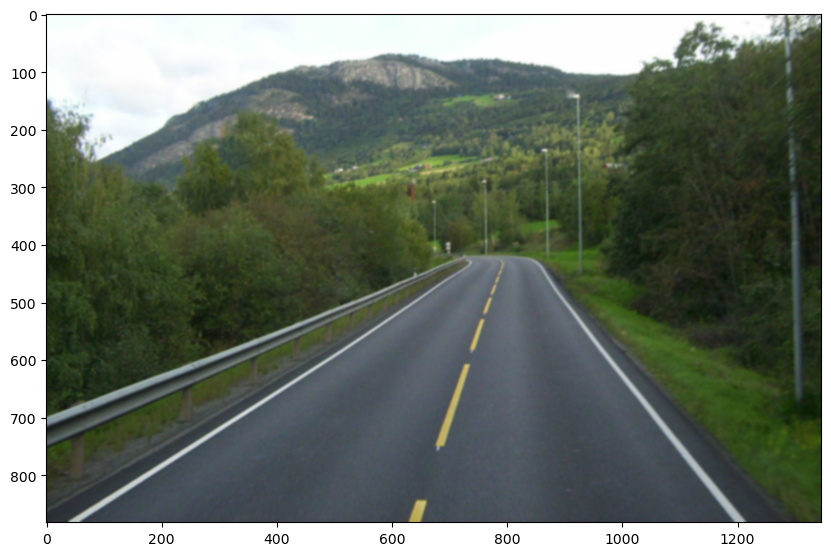

In [2]:
norway = cv2.imread('norway.jpg')
blurred_norway = cv2.GaussianBlur(norway, (9, 9), 0)
plt.subplots(1, 1, figsize=(10,10))[1].imshow(blurred_norway[..., ::-1]);

In [3]:
def rhotheta2xy(line):
    # konwersja parametrów prostej w układzie rho-theta do odcinka w układzie kartezjańskim
    # wynik można użyć jako argumenty funkcji cv2.line
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a*rho
    y0 = b*rho
    x1 = int(x0 + 5000*(-b))
    y1 = int(y0 + 5000*(a))
    x2 = int(x0 - 5000*(-b))
    y2 = int(y0 - 5000*(a))
    return x1, y1, x2, y2

Rozwiązanie:

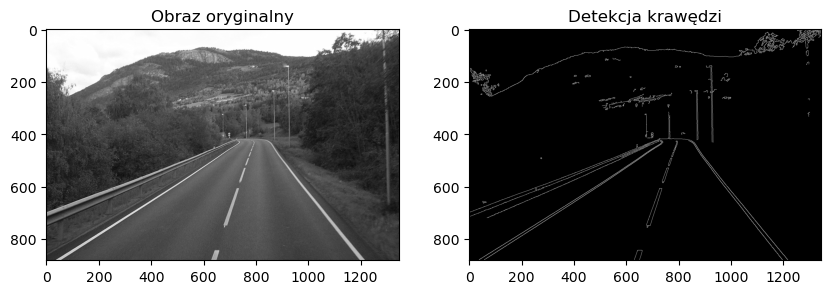

In [4]:
blurred_norway = cv2.GaussianBlur(norway, (5, 5), 0)
gray = cv2.cvtColor(norway, cv2.COLOR_BGR2GRAY)
gray_blur = cv2.cvtColor(blurred_norway, cv2.COLOR_BGR2GRAY)
blurred_gray = cv2.GaussianBlur(gray, (9, 9), 0)
edges = cv2.Canny(blurred_norway, 100, 250)

# Wyświetl wynik detekcji krawędzi
plt.figure(figsize=(10, 10))
plt.subplot(121), plt.imshow(gray, cmap='gray'), plt.title('Obraz oryginalny')
plt.subplot(122), plt.imshow(edges, cmap='gray'), plt.title('Detekcja krawędzi')
plt.show()

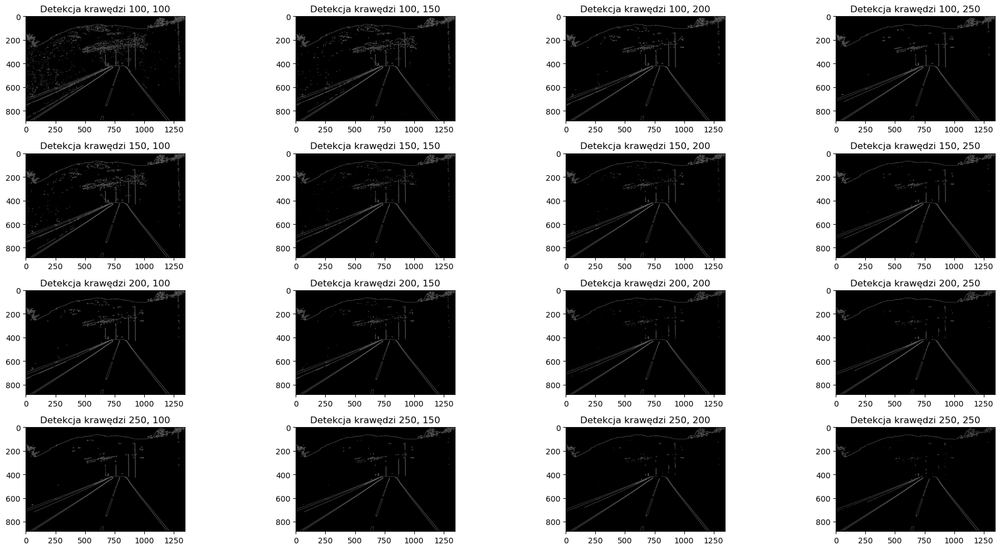

In [22]:
from tracemalloc import start


norway_copy = norway.copy()


# Detekcja krawędzi - użyj swojego ulubionego detektora krawędzi

low_tresh = [100, 150, 200, 250]
hight_tresh = [_, 100, 150, 200, 250]
plt.figure(figsize=(20, 10))
rows = 4
columns = 4
for x in range(rows):
    for y in range(1, columns+1):
        edges = cv2.Canny(blurred_norway, low_tresh[x], hight_tresh[y])
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(edges, cmap='gray'), plt.title(f'Detekcja krawędzi {low_tresh[x]}, {hight_tresh[y]}')

plt.tight_layout()
plt.show()



plt.show()

40


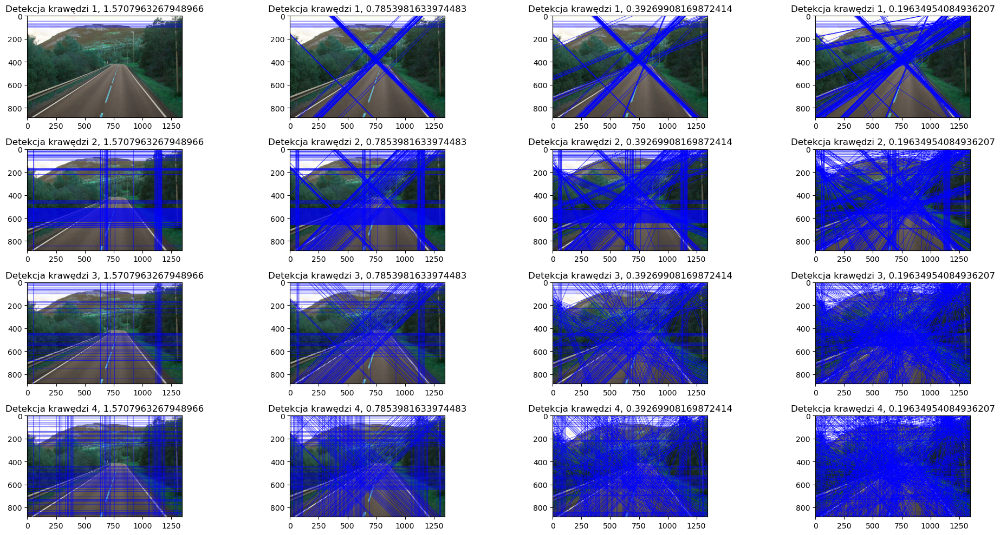

In [35]:
threshold = 40
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 2, np.pi / 4, np.pi / 8, np.pi / 16]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


85


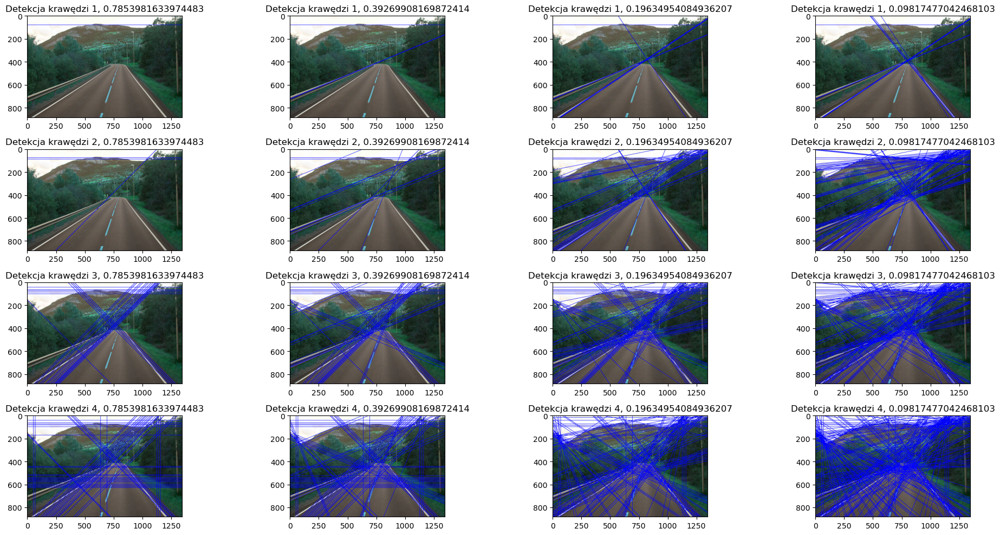

In [42]:
threshold = 85
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 4, np.pi / 8, np.pi / 16, np.pi / 32]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


40


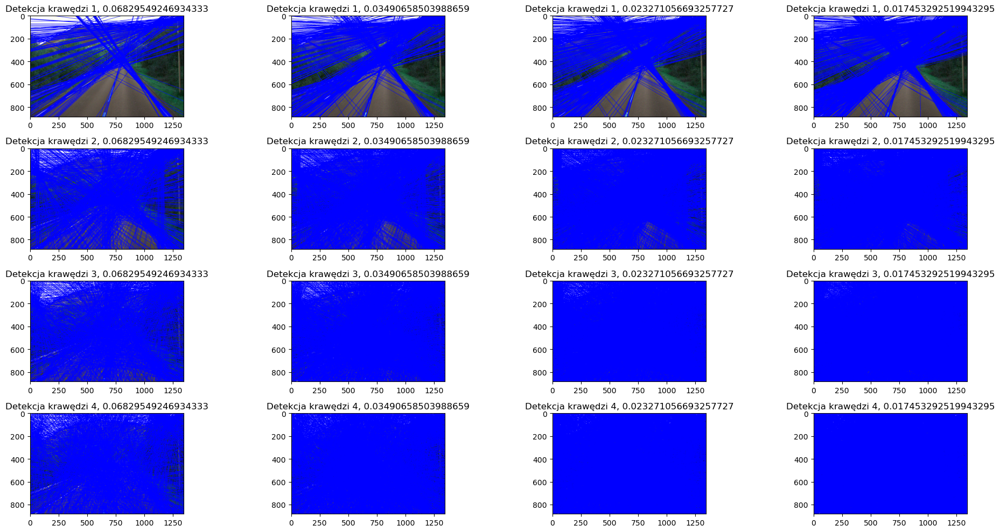

In [47]:
threshold = 40
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


80


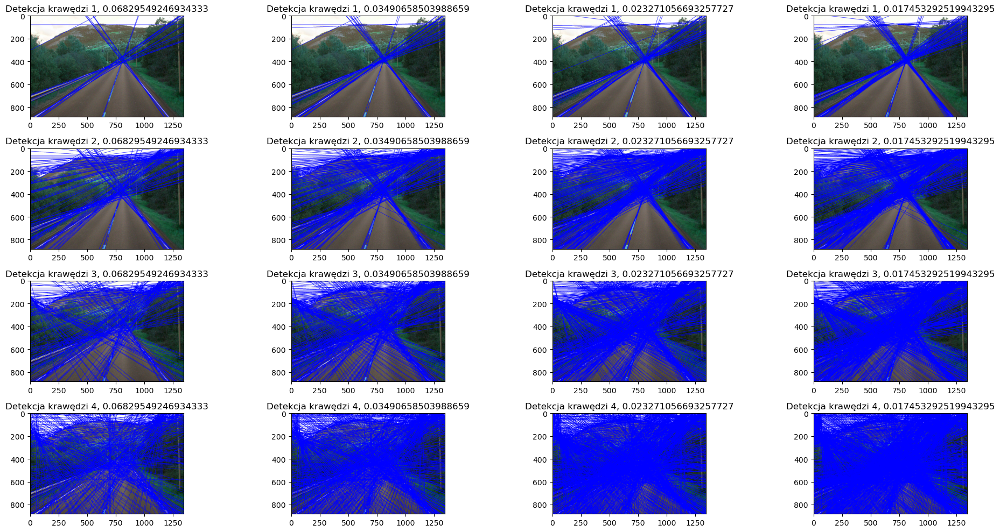

In [48]:
threshold = 80
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


120


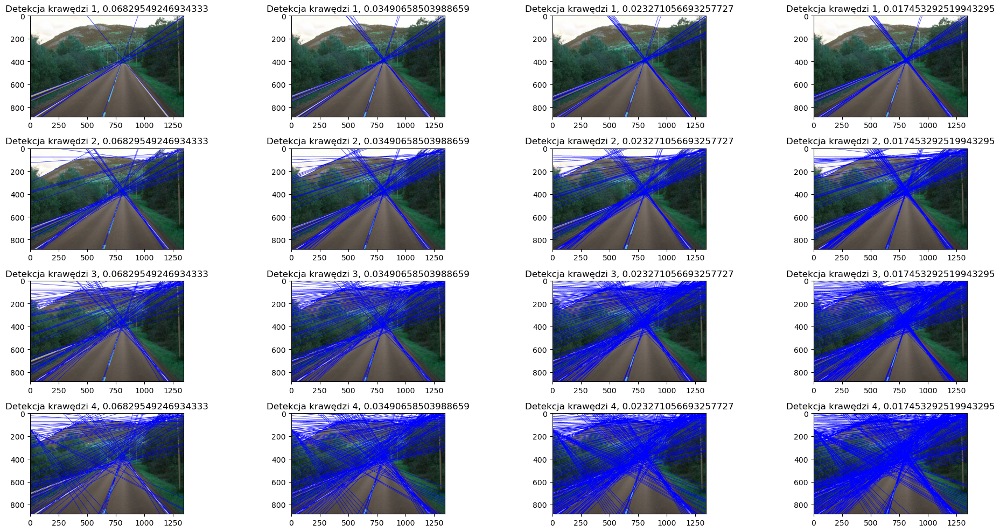

In [49]:
threshold = 120
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


160


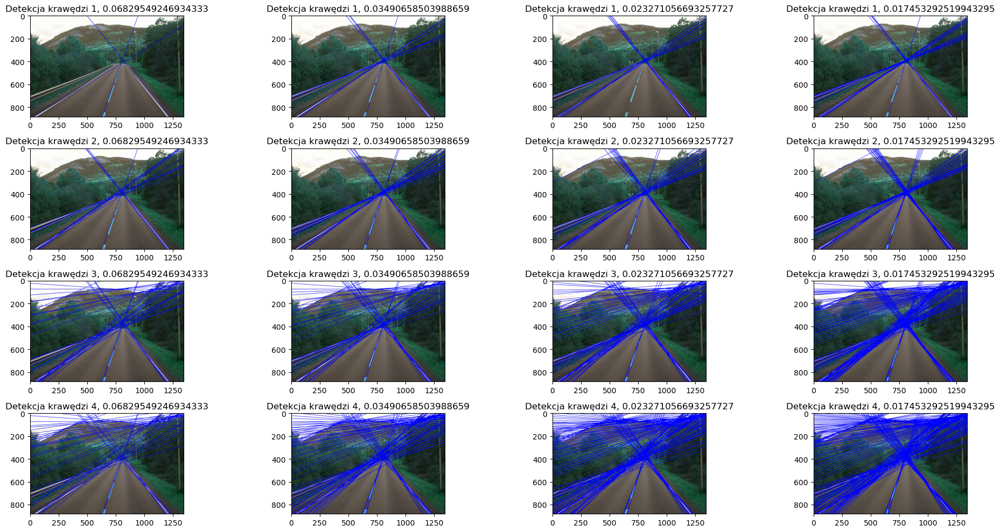

In [50]:
threshold = 160
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


200


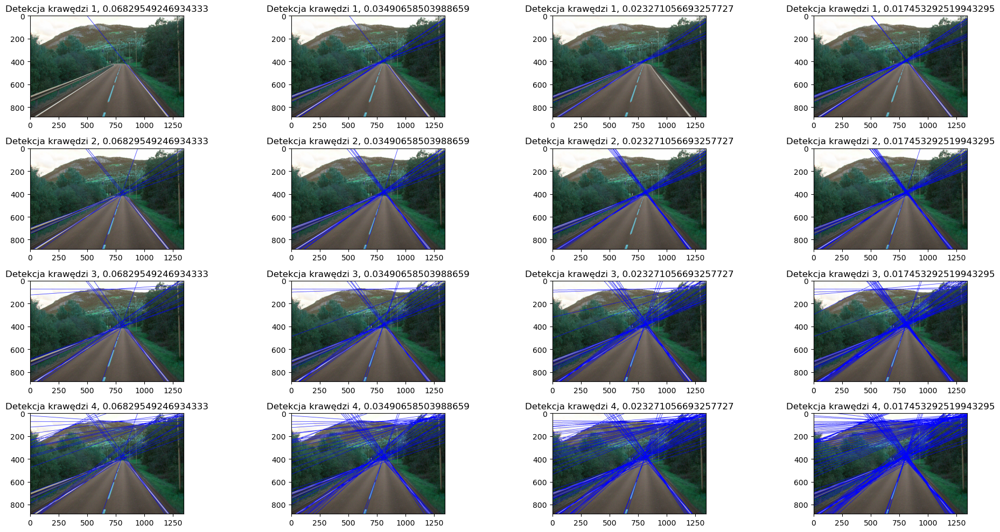

In [51]:
threshold = 200
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


240


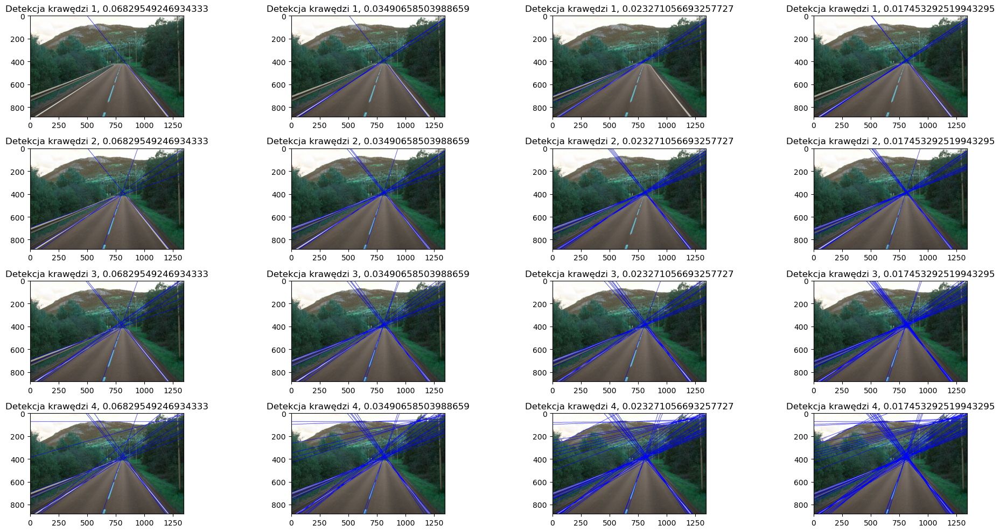

In [52]:
threshold = 240
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 45, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


280


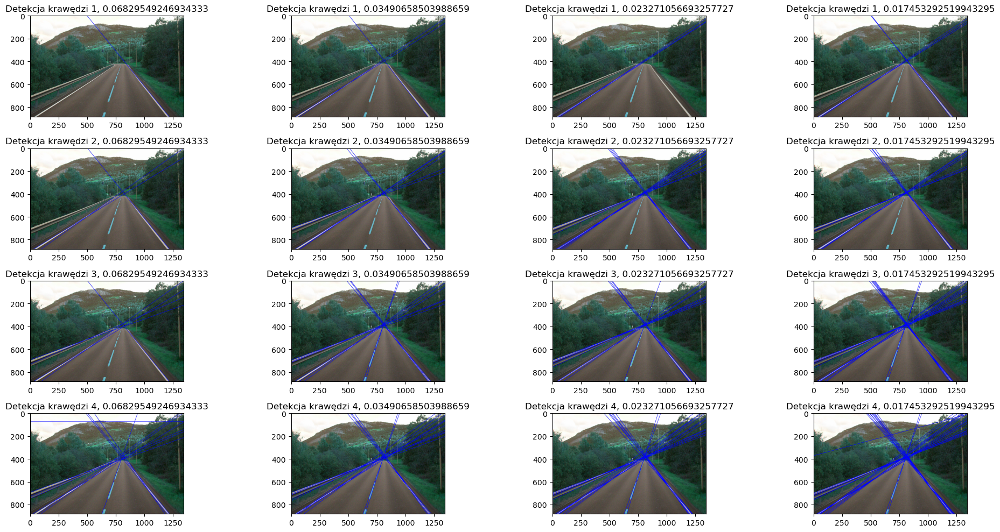

In [53]:
threshold = 280
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


320


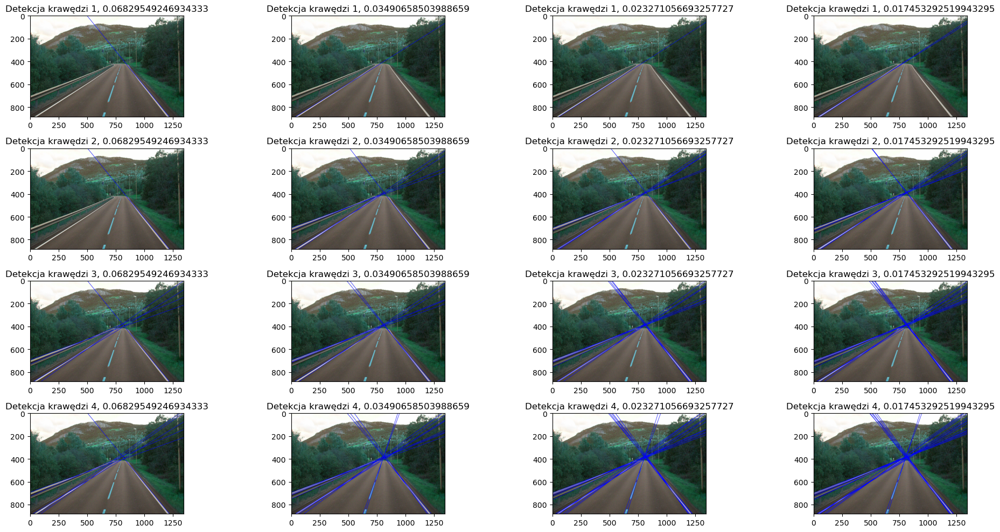

In [54]:
threshold = 320
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 46, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        norway_copy = norway.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(norway_copy, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


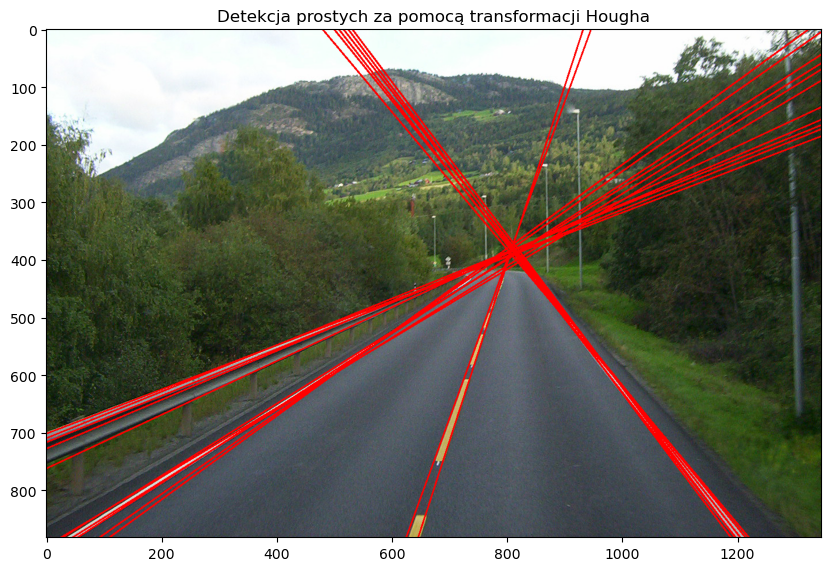

In [60]:
norway_copy = norway.copy()
gray_copy = gray.copy()
rho = 3        # Rozdzielczość akumulatora rho w pikselach
theta = np.pi / 180 # Rozdzielczość akumulatora theta w radianach
threshold = 280      # Prog detekcji - liczba głosów potrzebna do uznania linii za poprawną

# Wykonaj transformację Hougha
lines = cv2.HoughLines(edges, rho, theta, threshold)

# Nanieś odcinki na obraz oryginalny
for line in lines:
    x1, y1, x2, y2 = rhotheta2xy(line)
    cv2.line(norway_copy, (x1, y1), (x2, y2), (0, 0, 255), 2)

# Wyświetl wynik detekcji prostych
plt.figure(figsize=(10, 10))
plt.imshow(norway_copy[..., ::-1])
plt.title('Detekcja prostych za pomocą transformacji Hougha')
plt.show()

#### Zadanie 2

Dany jest obraz `pillbox`. Wykorzystaj transformację Hougha dla prostych, aby wykryć krawędzie między komórkami organizera.

Dla odmiany, w tym zadaniu nie jest istotne badanie parametrów ale wyłącznie końcowy wynik.

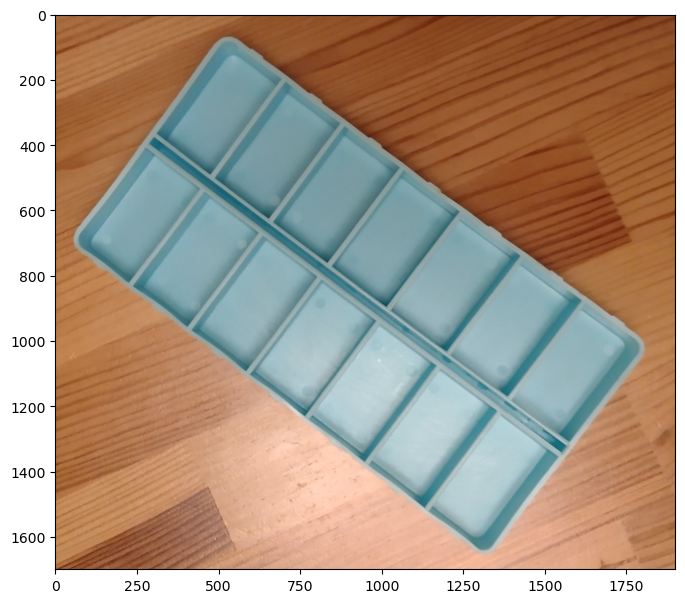

In [101]:
pillbox = cv2.imread('pillbox.png')
plt.subplots(1, 1, figsize=(8,8))[1].imshow(pillbox[..., ::-1]);

Rozwiązanie:

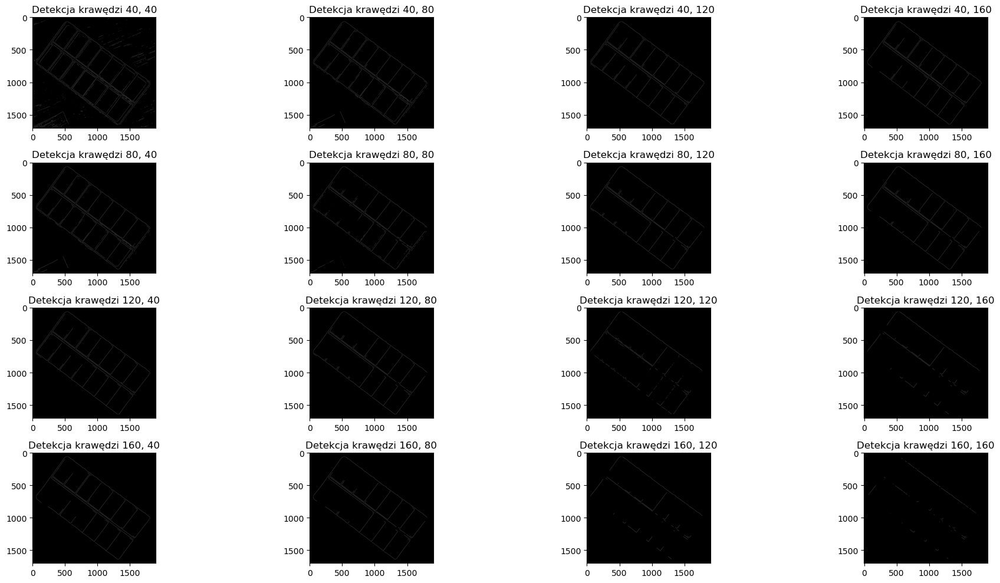

In [124]:
from tracemalloc import start




norway_copy = pillbox.copy()
blurred_norway = cv2.GaussianBlur(norway_copy, (13, 13), 0)
gray = cv2.cvtColor(norway_copy, cv2.COLOR_BGR2GRAY)
gray_blur = cv2.cvtColor(blurred_norway, cv2.COLOR_BGR2GRAY)

# Detekcja krawędzi - użyj swojego ulubionego detektora krawędzi

low_tresh = [40, 80, 120, 160]
hight_tresh = [_, 40, 80, 120, 160]
plt.figure(figsize=(20, 10))
rows = 4
columns = 4
for x in range(rows):
    for y in range(1, columns+1):
        edges = cv2.Canny(blurred_norway, low_tresh[x], hight_tresh[y])
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(edges, cmap='gray'), plt.title(f'Detekcja krawędzi {low_tresh[x]}, {hight_tresh[y]}')

plt.tight_layout()
plt.show()



plt.show()

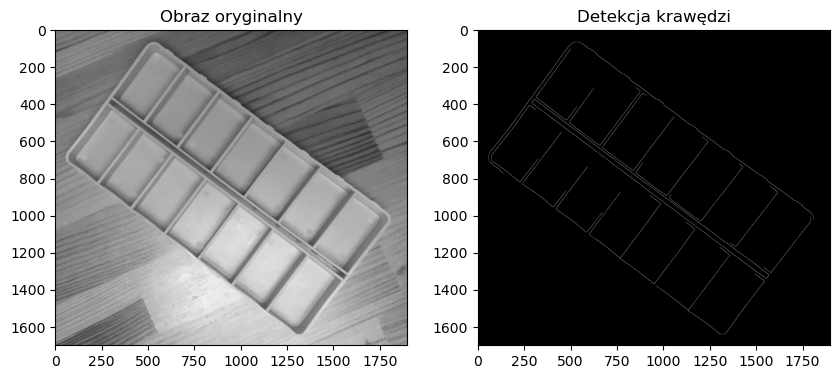

In [129]:

edges = cv2.Canny(blurred_norway, 40, 120)
# Wyświetl wynik detekcji krawędzi
plt.figure(figsize=(10, 10))
plt.subplot(121), plt.imshow(gray, cmap='gray'), plt.title('Obraz oryginalny')
plt.subplot(122), plt.imshow(edges, cmap='gray'), plt.title('Detekcja krawędzi')
plt.show()

240


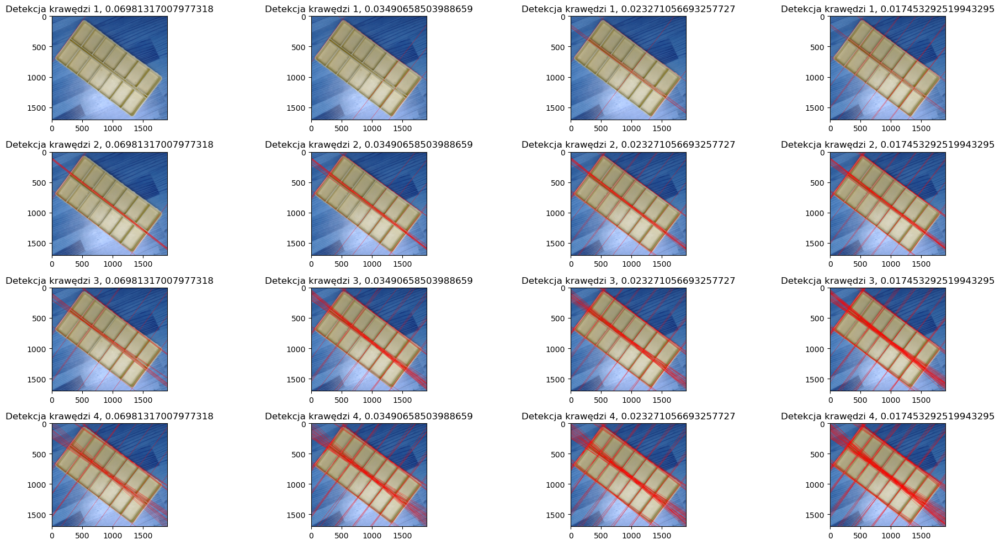

In [131]:
threshold = 240
rhos = [1, 2, 3, 4]
thetas = [_, np.pi / 45, np.pi / 90, np.pi / 135, np.pi / 180]
rows = 4
columns = 4
print(threshold)
plt.figure(figsize=(20, 10))

for x in range(rows):
    for y in range(1, columns+1):
        img = pillbox.copy()
        lines = cv2.HoughLines(edges, rhos[x], thetas[y], threshold)
        for line in lines:
            x1, y1, x2, y2 = rhotheta2xy(line)
            cv2.line(img, (x1, y1), (x2, y2), (255, 0, 0), 2)
        plt.subplot(rows, columns, x*4+y)
        plt.imshow(img, cmap='gray'), plt.title(f'Detekcja krawędzi {rhos[x]}, {thetas[y]}')

plt.tight_layout()
plt.show()


In [167]:
def remove_close_lines(lines, threshold):
    # Tworzymy kopię listy linii
    lines_copy = lines.copy()
    deleted = []
    # Iterujemy przez każdą linię
    for i in range(len(lines_copy)):
        # Pobieramy parametry ρ i θ dla bieżącej linii
        if i in deleted:
            continue
        rho_i, theta_i = lines_copy[i][0]
        # Iterujemy przez pozostałe linie
        for j in range(i + 1, len(lines_copy)):
            if j in deleted:
                continue
            # Pobieramy parametry ρ i θ dla drugiej linii
            rho_j, theta_j = lines_copy[j][0]

            # Sprawdzamy, czy wartość ρ dla bieżącej linii jest mniejsza niż threshold od wartości ρ dla drugiej linii
            if abs(rho_i - rho_j) < threshold:
                deleted.append(j)
    return  np.delete(lines_copy, deleted, axis=0)
    
            


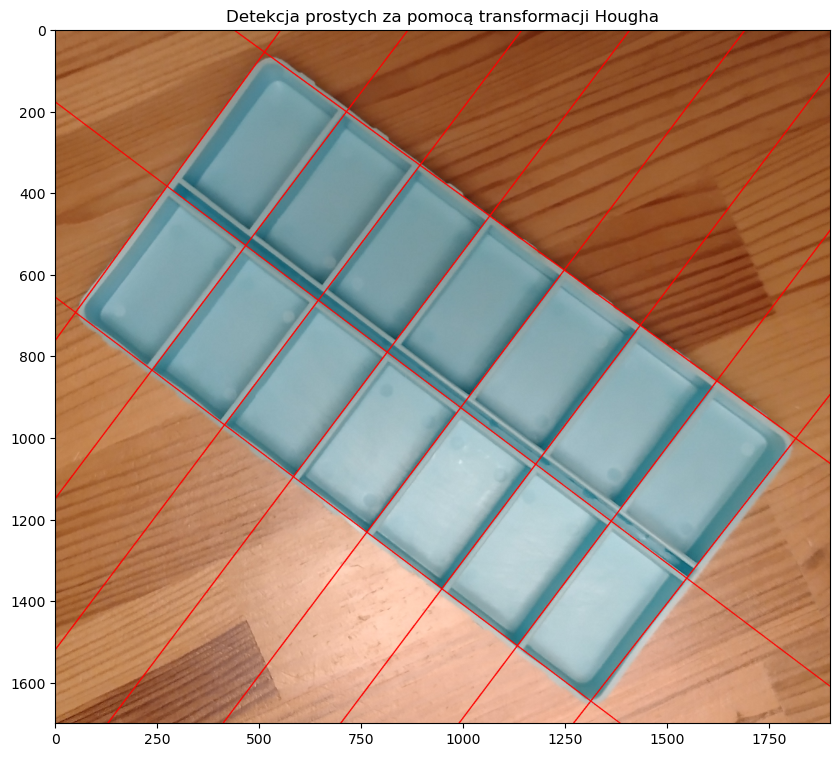

In [175]:
norway_copy = norway.copy()
gray_copy = gray.copy()

rho = 1        # Rozdzielczość akumulatora rho w pikselach
theta = np.pi / 180 # Rozdzielczość akumulatora theta w radianach
threshold = 220      # Prog detekcji - liczba głosów potrzebna do uznania linii za poprawną

# Wykonaj transformację Hougha
lines = cv2.HoughLines(edges, rho, theta, threshold)
filtered_lines = remove_close_lines(lines, threshold=50)
img = pillbox.copy()
# Nanieś odcinki na obraz oryginalny
for line in filtered_lines:
    x1, y1, x2, y2 = rhotheta2xy(line)
    cv2.line(img, (x1, y1), (x2, y2), (0, 0, 255), 2)

# Wyświetl wynik detekcji prostych
plt.figure(figsize=(10, 10))
plt.imshow(img[..., ::-1])
plt.title('Detekcja prostych za pomocą transformacji Hougha')
plt.show()